In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
!ls

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive
drive  sample_data


In [2]:
%cd drive/Shared\ drives/repo/TensorFlow-2.x-YOLOv3/
!ls

/content/drive/Shared drives/repo/TensorFlow-2.x-YOLOv3
checkpoints	     mnist	       train.py
detection_custom.py  model_data        train_star.ipynb
detection_demo.py    README.md	       Untitled0.ipynb
detect_mnist.py      requirements.txt  yolov3
IMAGES		     star	       YOLOv3_colab_training.ipynb
log		     tools


In [0]:
!python train.py

2020-06-16 01:18:09.193008: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
2020-06-16 01:18:13.462933: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-06-16 01:18:13.512883: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-06-16 01:18:13.513538: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2020-06-16 01:18:13.513585: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
2020-06-16 01:18:13.753997: I tensorflow/stream_executor/pl

In [2]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline  
import tensorflow as tf
from yolov3.yolov3 import Create_Yolov3
from yolov3.utils import load_yolo_weights, detect_image
from yolov3.configs import *

input_size = YOLO_INPUT_SIZE
Darknet_weights = YOLO_DARKNET_WEIGHTS

#yolo = Create_Yolov3(input_size=input_size)
#load_yolo_weights(yolo, Darknet_weights) # use Darknet weight


In [16]:
import colorsys
import random

In [15]:
def image_preprocess(image, target_size, gt_boxes=None):
    ih, iw    = target_size
    h,  w, _  = image.shape

    scale = min(iw/w, ih/h)
    nw, nh  = int(scale * w), int(scale * h)
    image_resized = cv2.resize(image, (nw, nh))

    image_paded = np.full(shape=[ih, iw, 3], fill_value=128.0)
    dw, dh = (iw - nw) // 2, (ih-nh) // 2
    image_paded[dh:nh+dh, dw:nw+dw, :] = image_resized
    image_paded = image_paded / 255.

    if gt_boxes is None:
        return image_paded

    else:
        gt_boxes[:, [0, 2]] = gt_boxes[:, [0, 2]] * scale + dw
        gt_boxes[:, [1, 3]] = gt_boxes[:, [1, 3]] * scale + dh
        return image_paded, gt_boxes


def postprocess_boxes(pred_bbox, original_image, input_size, score_threshold):
    valid_scale=[0, np.inf]
    pred_bbox = np.array(pred_bbox)

    pred_xywh = pred_bbox[:, 0:4]
    pred_conf = pred_bbox[:, 4]
    pred_prob = pred_bbox[:, 5:]

    # 1. (x, y, w, h) --> (xmin, ymin, xmax, ymax)
    pred_coor = np.concatenate([pred_xywh[:, :2] - pred_xywh[:, 2:] * 0.5,
                                pred_xywh[:, :2] + pred_xywh[:, 2:] * 0.5], axis=-1)
    # 2. (xmin, ymin, xmax, ymax) -> (xmin_org, ymin_org, xmax_org, ymax_org)
    org_h, org_w = original_image.shape[:2]
    resize_ratio = min(input_size / org_w, input_size / org_h)

    dw = (input_size - resize_ratio * org_w) / 2
    dh = (input_size - resize_ratio * org_h) / 2

    pred_coor[:, 0::2] = 1.0 * (pred_coor[:, 0::2] - dw) / resize_ratio
    pred_coor[:, 1::2] = 1.0 * (pred_coor[:, 1::2] - dh) / resize_ratio

    # 3. clip some boxes those are out of range
    pred_coor = np.concatenate([np.maximum(pred_coor[:, :2], [0, 0]),
                                np.minimum(pred_coor[:, 2:], [org_w - 1, org_h - 1])], axis=-1)
    invalid_mask = np.logical_or((pred_coor[:, 0] > pred_coor[:, 2]), (pred_coor[:, 1] > pred_coor[:, 3]))
    pred_coor[invalid_mask] = 0

    # 4. discard some invalid boxes
    bboxes_scale = np.sqrt(np.multiply.reduce(pred_coor[:, 2:4] - pred_coor[:, 0:2], axis=-1))
    scale_mask = np.logical_and((valid_scale[0] < bboxes_scale), (bboxes_scale < valid_scale[1]))

    # 5. discard boxes with low scores
    classes = np.argmax(pred_prob, axis=-1)
    scores = pred_conf * pred_prob[np.arange(len(pred_coor)), classes]
    score_mask = scores > score_threshold
    mask = np.logical_and(scale_mask, score_mask)
    coors, scores, classes = pred_coor[mask], scores[mask], classes[mask]

    return np.concatenate([coors, scores[:, np.newaxis], classes[:, np.newaxis]], axis=-1)


def nms(bboxes, iou_threshold, sigma=0.3, method='nms'):
    """
    :param bboxes: (xmin, ymin, xmax, ymax, score, class)

    Note: soft-nms, https://arxiv.org/pdf/1704.04503.pdf
          https://github.com/bharatsingh430/soft-nms
    """
    classes_in_img = list(set(bboxes[:, 5]))
    best_bboxes = []

    for cls in classes_in_img:
        cls_mask = (bboxes[:, 5] == cls)
        cls_bboxes = bboxes[cls_mask]
        # Process 1: Determine whether the number of bounding boxes is greater than 0 
        while len(cls_bboxes) > 0:
            # Process 2: Select the bounding box with the highest score according to socre order A
            max_ind = np.argmax(cls_bboxes[:, 4])
            best_bbox = cls_bboxes[max_ind]
            best_bboxes.append(best_bbox)
            cls_bboxes = np.concatenate([cls_bboxes[: max_ind], cls_bboxes[max_ind + 1:]])
            # Process 3: Calculate this bounding box A and
            # Remain all iou of the bounding box and remove those bounding boxes whose iou value is higher than the threshold 
            iou = bboxes_iou(best_bbox[np.newaxis, :4], cls_bboxes[:, :4])
            weight = np.ones((len(iou),), dtype=np.float32)

            assert method in ['nms', 'soft-nms']

            if method == 'nms':
                iou_mask = iou > iou_threshold
                weight[iou_mask] = 0.0

            if method == 'soft-nms':
                weight = np.exp(-(1.0 * iou ** 2 / sigma))

            cls_bboxes[:, 4] = cls_bboxes[:, 4] * weight
            score_mask = cls_bboxes[:, 4] > 0.
            cls_bboxes = cls_bboxes[score_mask]

    return best_bboxes


def draw_bbox(image, bboxes, CLASSES=YOLO_COCO_CLASSES, show_label=True, show_confidence = True, Text_colors=(255,255,0), rectangle_colors=''):   
    NUM_CLASS = read_class_names(CLASSES)
    num_classes = len(NUM_CLASS)
    image_h, image_w, _ = image.shape
    hsv_tuples = [(1.0 * x / num_classes, 1., 1.) for x in range(num_classes)]
    #print("hsv_tuples", hsv_tuples)
    colors = list(map(lambda x: colorsys.hsv_to_rgb(*x), hsv_tuples))
    colors = list(map(lambda x: (int(x[0] * 255), int(x[1] * 255), int(x[2] * 255)), colors))

    random.seed(0)
    random.shuffle(colors)
    random.seed(None)

    for i, bbox in enumerate(bboxes):
        coor = np.array(bbox[:4], dtype=np.int32)
        score = bbox[4]
        class_ind = int(bbox[5])
        bbox_color = rectangle_colors if rectangle_colors != ''else colors[class_ind]
        bbox_thick = int(0.6 * (image_h + image_w) / 1000)
        if bbox_thick < 1: bbox_thick = 1
        #print(image_h, image_w, bbox_thick)
        fontScale = 0.75 * bbox_thick
        (x1, y1), (x2, y2) = (coor[0], coor[1]), (coor[2], coor[3])

        # put object rectangle
        cv2.rectangle(image, (x1, y1), (x2, y2), bbox_color, bbox_thick*2)

        if show_label:
            # get text label
            #score_str = f' {score:.2f}' if show_confidence else ''
            score_str = " {:.2f}".format(score) if show_confidence else "" 
            #label = f'{NUM_CLASS[class_ind]}' + score_str
            label = "{}".format(NUM_CLASS[class_ind]) + score_str

            # get text size
            (text_width, text_height), baseline = cv2.getTextSize(label, cv2.FONT_HERSHEY_COMPLEX_SMALL,
                                                                  fontScale, thickness=bbox_thick)
            # put filled text rectangle
            cv2.rectangle(image, (x1, y1), (x1 + text_width, y1 - text_height - baseline), bbox_color, thickness=cv2.FILLED)

            # put text above rectangle
            cv2.putText(image, label, (x1, y1-4), cv2.FONT_HERSHEY_COMPLEX_SMALL,
                        fontScale, Text_colors, bbox_thick, lineType=cv2.LINE_AA)

    return image



def bboxes_iou(boxes1, boxes2):
    boxes1 = np.array(boxes1)
    boxes2 = np.array(boxes2)

    boxes1_area = (boxes1[..., 2] - boxes1[..., 0]) * (boxes1[..., 3] - boxes1[..., 1])
    boxes2_area = (boxes2[..., 2] - boxes2[..., 0]) * (boxes2[..., 3] - boxes2[..., 1])

    left_up       = np.maximum(boxes1[..., :2], boxes2[..., :2])
    right_down    = np.minimum(boxes1[..., 2:], boxes2[..., 2:])

    inter_section = np.maximum(right_down - left_up, 0.0)
    inter_area    = inter_section[..., 0] * inter_section[..., 1]
    union_area    = boxes1_area + boxes2_area - inter_area
    ious          = np.maximum(1.0 * inter_area / union_area, np.finfo(np.float32).eps)

    return ious

def read_class_names(class_file_name):
    # loads class name from a file
    names = {}
    with open(class_file_name, 'r') as data:
        for ID, name in enumerate(data):
            names[ID] = name.strip('\n')
    return names


In [74]:
def detect_(yolo, image_path = "./star/0.jpg", score_th=0.5, iou_th=0.45):

    original_image      = cv2.imread(image_path)
    #original_image      = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    #original_image      = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    
    image_data = image_preprocess(np.copy(original_image), [input_size, input_size])
    image_data = tf.expand_dims(image_data, 0)
    
    pred_bbox = yolo.predict(image_data)
    pred_bbox = [tf.reshape(x, (-1, tf.shape(x)[-1])) for x in pred_bbox]
    pred_bbox = tf.concat(pred_bbox, axis=0)
        
    bboxes = postprocess_boxes(pred_bbox, original_image, input_size, score_threshold=score_th)
    bboxes = nms(bboxes, iou_threshold=iou_th, method='nms')
    
    image = draw_bbox(original_image, bboxes, CLASSES=TRAIN_CLASSES, 
                      Text_colors=(255,0,0),
                      rectangle_colors=(128,255,0))
    
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    return bboxes

In [39]:
yolo = Create_Yolov3(input_size=input_size, CLASSES=TRAIN_CLASSES)
yolo.load_weights("./checkpoints/yolov3_star") # use weights at epoch 60


In [133]:
yolo_20 = Create_Yolov3(input_size=input_size, CLASSES=TRAIN_CLASSES)
yolo_20.load_weights("./checkpoints/epoch20/yolov3_star") # use weights at epoch 20


In [134]:
yolo_30 = Create_Yolov3(input_size=input_size, CLASSES=TRAIN_CLASSES)
yolo_30.load_weights("./checkpoints/epoch30/yolov3_star") # use weights at epoch 20


[array([ 51.93909454, 177.5506897 , 157.87075806, 285.00082397,
          0.98722333,   0.        ]),
 array([209.77052307,  75.59657288, 293.25143433, 159.30606079,
          0.98538011,   1.        ]),
 array([199.8722229 , 105.78765869, 265.03378296, 169.68890381,
          0.93541032,   1.        ]),
 array([ 58.53039169, 189.24035645, 151.29951477, 291.22195435,
          0.42206776,   1.        ])]

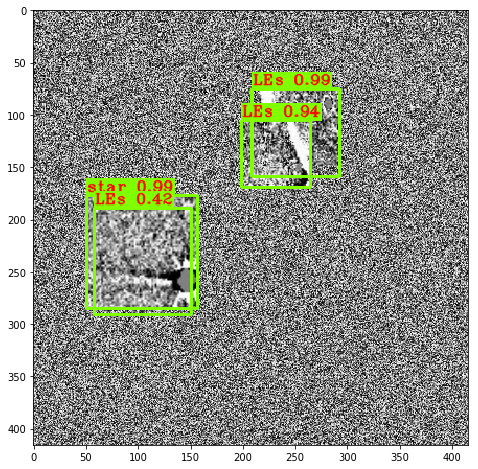

In [80]:
detect_(yolo, image_path='star/star_test/000010.jpg', score_th=0.3, iou_th=0.45)


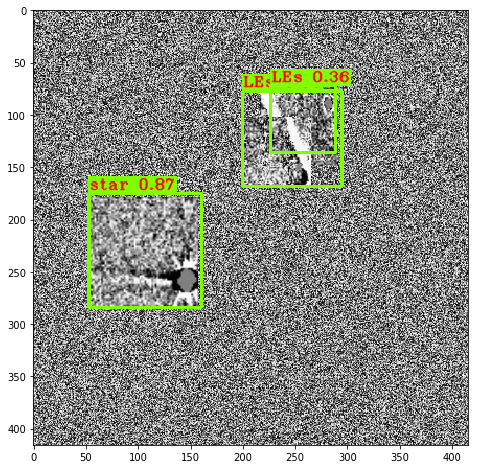

In [77]:
detect_(yolo_1, image_path='star/star_test/000010.jpg', score_th=0.3, iou_th=0.45)


[array([ 15.60852814, 140.57891846, 190.22225952, 326.86849976,
          0.4650346 ,   0.        ]),
 array([  4.80165482, 145.79354858, 110.92784119, 252.24655151,
          0.34766299,   0.        ]),
 array([  9.39849091,   0.        , 213.96582031, 211.65481567,
          0.24281512,   0.        ]),
 array([6.47101288e+01, 1.45306168e+01, 3.49149658e+02, 2.56668030e+02,
        2.27739945e-01, 1.00000000e+00])]

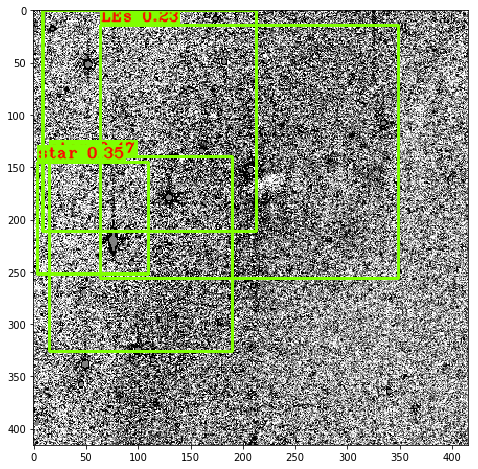

In [90]:
detect_(yolo, image_path='star/12.jpg', score_th=0.2, iou_th=0.45)


[array([5.25994751e+02, 6.44871704e+02, 6.22779175e+02, 7.39291443e+02,
        6.78215444e-01, 0.00000000e+00]),
 array([168.66609192, 285.13299561, 230.70661926, 340.90786743,
          0.54785383,   0.        ]),
 array([1.89351089e+02, 6.64913635e+02, 2.54074356e+02, 7.22621460e+02,
        2.20136717e-01, 0.00000000e+00]),
 array([1.85293106e+02, 6.71697510e+02, 2.21427734e+02, 7.05375488e+02,
        1.87242672e-01, 0.00000000e+00]),
 array([3.64341095e+02, 6.09601624e+02, 4.83286316e+02, 7.20399597e+02,
        1.37191623e-01, 0.00000000e+00]),
 array([1.65399216e+02, 2.63537659e+02, 2.59712311e+02, 3.55521790e+02,
        1.29478484e-01, 0.00000000e+00]),
 array([5.18514328e+01, 2.13533813e+02, 7.79373856e+01, 2.41431503e+02,
        1.28387138e-01, 0.00000000e+00]),
 array([3.69425476e+02, 6.49295715e+02, 4.45615936e+02, 7.22590637e+02,
        1.11899629e-01, 0.00000000e+00]),
 array([6.31748108e+02, 2.79846863e+02, 7.00388855e+02, 3.43589722e+02,
        3.24331075e-01, 1.00

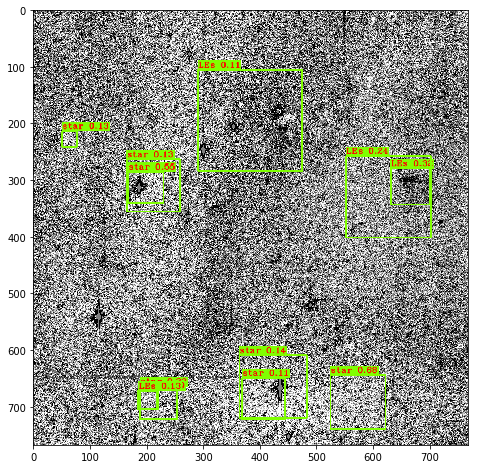

In [88]:
detect_(yolo_1, image_path='star/12_2.jpg', score_th=0.1, iou_th=0.45)


[array([ 16.60832596, 191.94683838,  93.42382812, 269.5536499 ,
          0.27889943,   0.        ]),
 array([2.99225708e+02, 2.38986511e+02, 3.51795288e+02, 2.91022156e+02,
        1.61873385e-01, 0.00000000e+00]),
 array([1.83732513e+02, 1.46199585e+02, 2.50768127e+02, 2.13684875e+02,
        1.40670121e-01, 1.00000000e+00])]

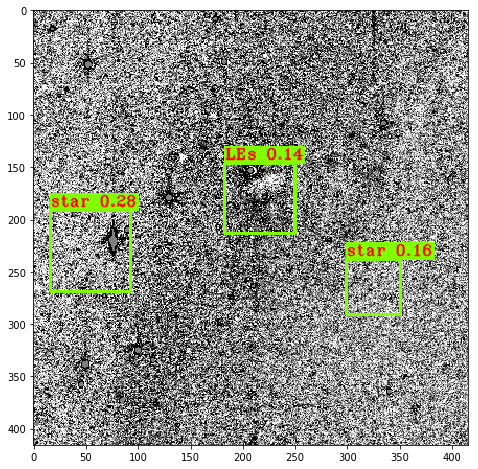

In [86]:
detect_(yolo_1, image_path='star/12.jpg', score_th=0.13, iou_th=0.45)


[array([104.04036713, 127.97361755, 137.79666138, 162.81541443,
          0.99197888,   0.        ]),
 array([185.07191467,  78.31988525, 351.47790527, 243.92575073,
          0.98781753,   0.        ]),
 array([  6.53328705, 200.77041626,  38.87791443, 233.3092041 ,
          0.76936817,   0.        ]),
 array([  5.91567039, 200.67378235,  38.30463409, 233.18681335,
          0.69972748,   1.        ])]

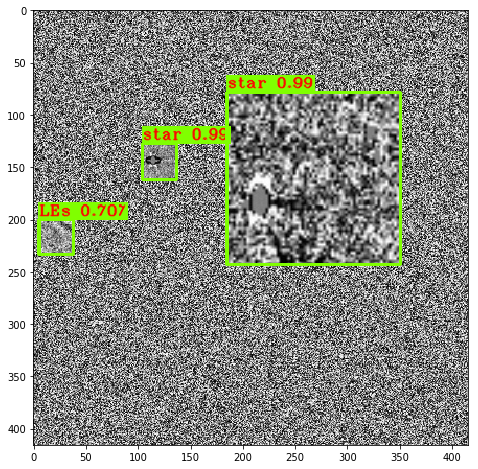

In [92]:
detect_(yolo, image_path='star/new/imgs/000012.jpg', score_th=0.13, iou_th=0.45)


[array([104.15093994, 126.93486023, 137.96064758, 163.33970642,
          0.97195154,   0.        ]),
 array([184.49107361,  73.97301483, 350.99053955, 241.89849854,
          0.95255935,   0.        ]),
 array([  6.06466293, 200.02510071,  39.07548523, 233.75083923,
          0.8683579 ,   0.        ])]

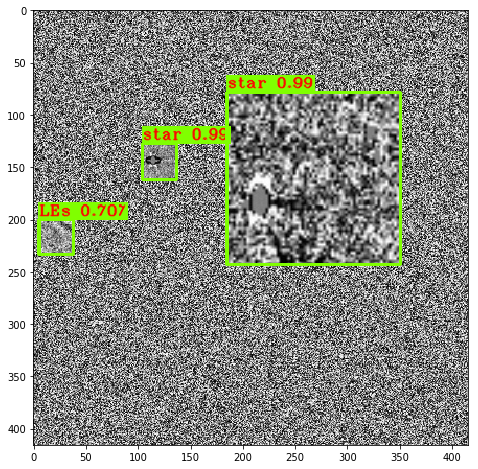

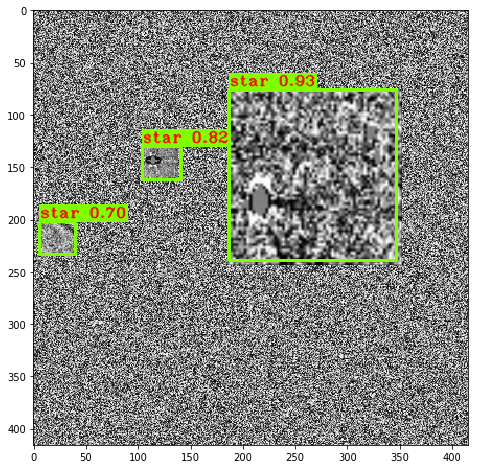

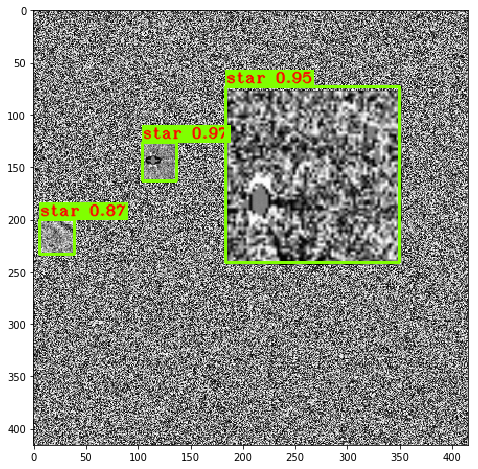

In [136]:
detect_(yolo, image_path='star/new/imgs/000012.jpg', score_th=0.13, iou_th=0.45)
detect_(yolo_20, image_path='star/new/imgs/000012.jpg', score_th=0.13, iou_th=0.45)
detect_(yolo_30, image_path='star/new/imgs/000012.jpg', score_th=0.13, iou_th=0.45)


[array([ 65.32587433, 294.40579224, 196.78143311, 426.47412109,
          0.9519943 ,   0.        ]),
 array([543.17114258, 478.13214111, 654.80145264, 592.88824463,
          0.90292203,   0.        ]),
 array([293.17163086, 545.07946777, 426.82028198, 682.00701904,
          0.80476469,   0.        ]),
 array([6.59265198e+02, 3.02955933e+02, 7.65065308e+02, 4.12735474e+02,
        3.52096111e-01, 0.00000000e+00]),
 array([6.00793335e+02, 6.91480286e+02, 6.80702820e+02, 7.67000000e+02,
        2.28709430e-01, 0.00000000e+00]),
 array([6.48599854e+02, 2.97166718e+02, 7.58406189e+02, 4.03187775e+02,
        5.13679087e-01, 1.00000000e+00]),
 array([6.15434631e+02, 6.89354675e+02, 7.06534729e+02, 7.67000000e+02,
        2.59013742e-01, 1.00000000e+00])]

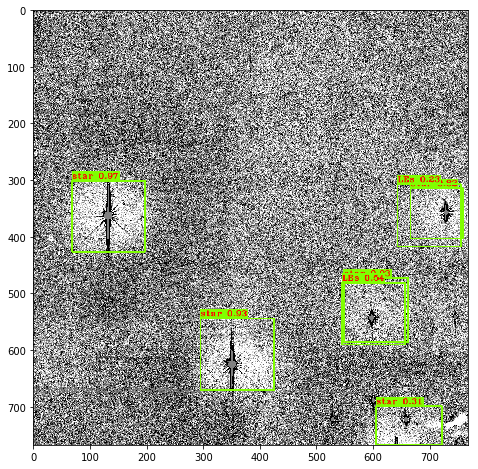

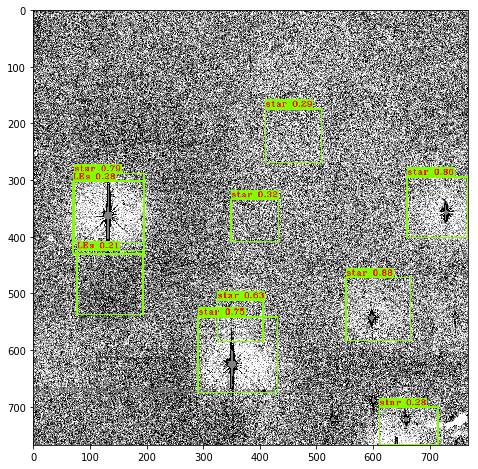

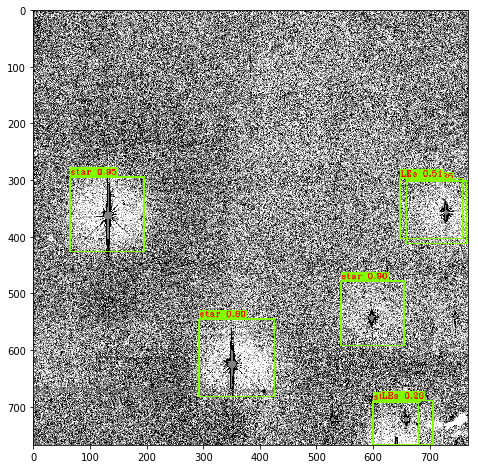

In [141]:
image_path='star/unique_croped/10.jpg'
score_th=0.2
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


[array([602.84344482,  16.44458199, 706.9644165 , 121.9054718 ,
          0.7304045 ,   0.        ]),
 array([5.43189697e+02, 2.20580032e+02, 6.01540039e+02, 2.77701599e+02,
        3.40314567e-01, 0.00000000e+00]),
 array([3.94035858e+02, 3.89377533e+02, 6.06880005e+02, 5.99226562e+02,
        5.03399193e-01, 1.00000000e+00]),
 array([5.08061584e+02, 3.63488770e+02, 5.89278931e+02, 4.36923309e+02,
        2.96762317e-01, 1.00000000e+00])]

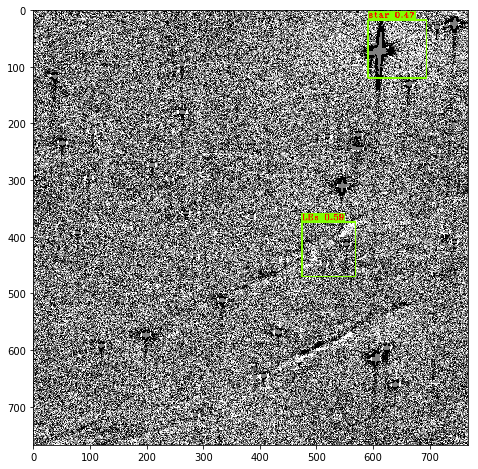

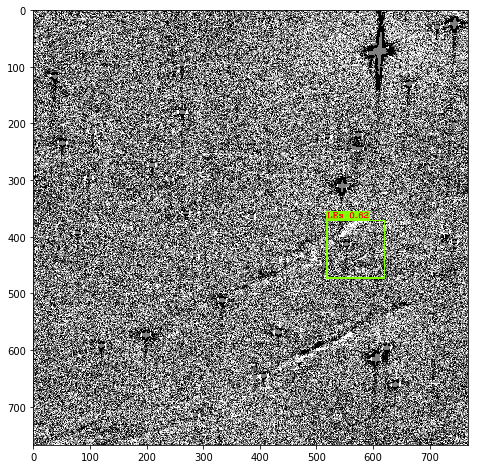

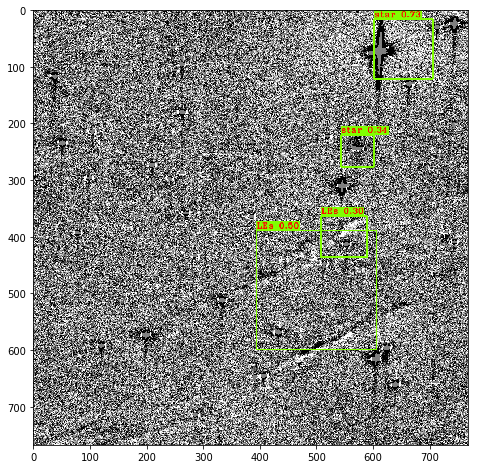

In [143]:
image_path='star/unique_croped/6.jpg'
score_th=0.2
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


[array([503.42868042, 428.78903198, 628.17108154, 554.80041504,
          0.7778486 ,   0.        ]),
 array([9.58091125e+01, 3.68712006e+02, 1.64671677e+02, 4.35733948e+02,
        2.92913646e-01, 1.00000000e+00])]

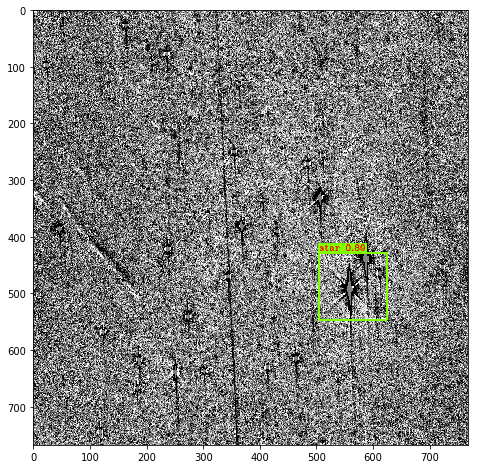

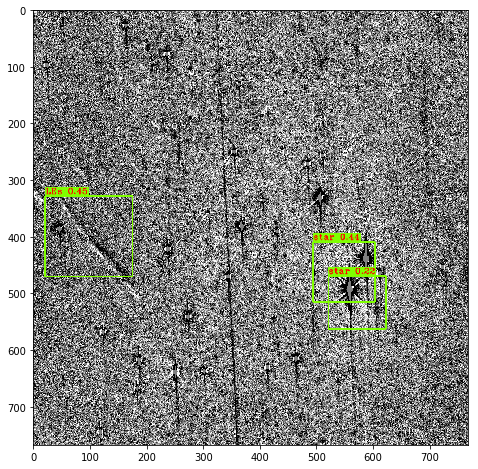

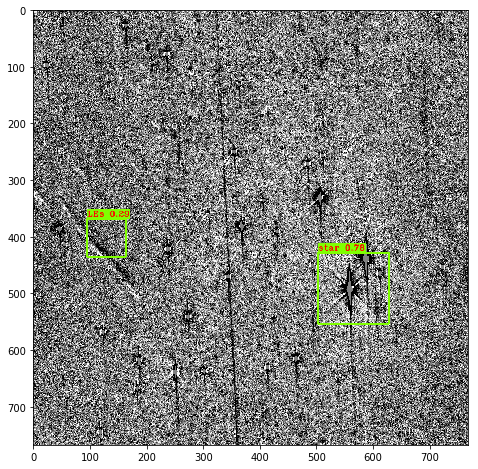

In [145]:
image_path='star/unique_croped/20.jpg'
score_th=0.2
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


[array([1.56550598e+02, 6.94208496e+02, 2.05090805e+02, 7.42082581e+02,
        2.08140135e-01, 0.00000000e+00]),
 array([587.63092041,  45.32901001, 736.9788208 , 202.78300476,
          0.76878506,   1.        ]),
 array([5.81808899e+02, 1.04791496e+02, 6.78892456e+02, 2.07131256e+02,
        5.01909375e-01, 1.00000000e+00]),
 array([227.05836487, 189.86479187, 337.05447388, 302.37069702,
          0.44517323,   1.        ]),
 array([1.79212189e+02, 2.10744522e+02, 2.72323669e+02, 2.96673615e+02,
        2.17493564e-01, 1.00000000e+00])]

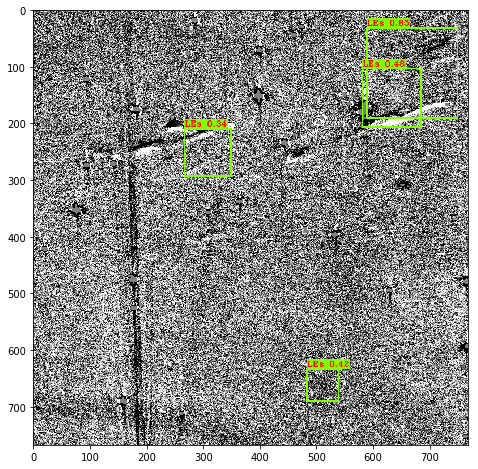

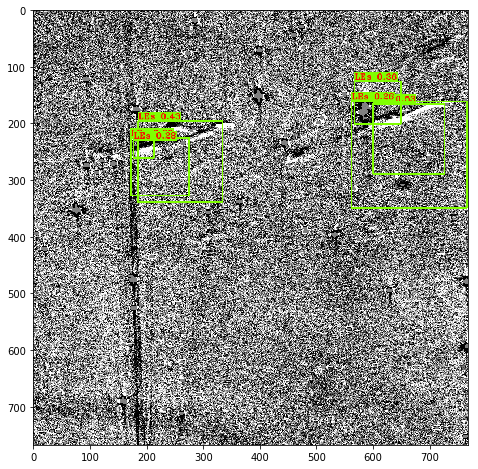

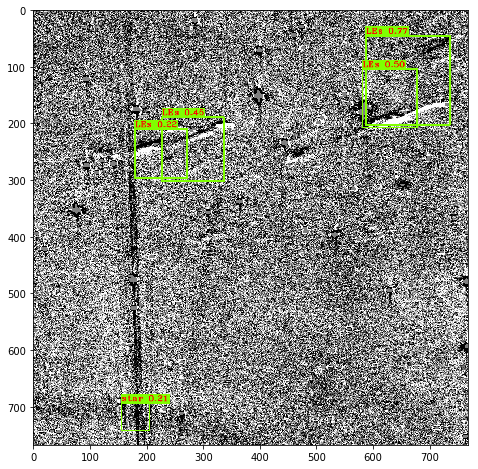

In [149]:
image_path='star/unique_croped/3.jpg'
score_th=0.2
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


[array([9.91474838e+01, 5.93033142e+02, 2.00325150e+02, 6.93964661e+02,
        4.68696177e-01, 1.00000000e+00]),
 array([4.13575287e+02, 6.43867432e+02, 5.39076782e+02, 7.75440002e+02,
        4.29338247e-01, 1.00000000e+00])]

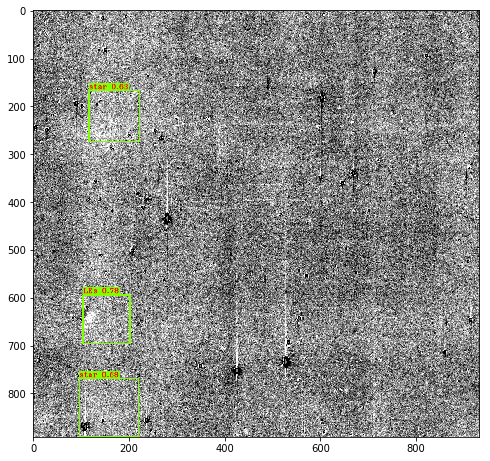

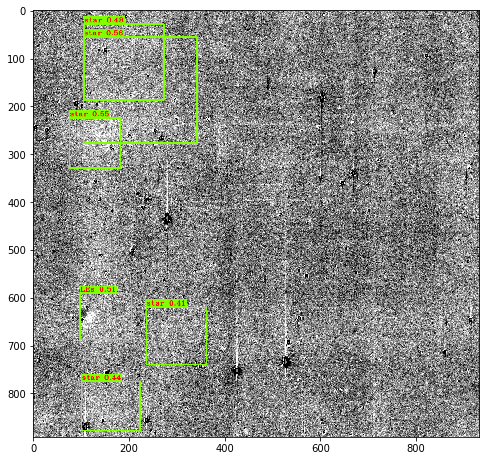

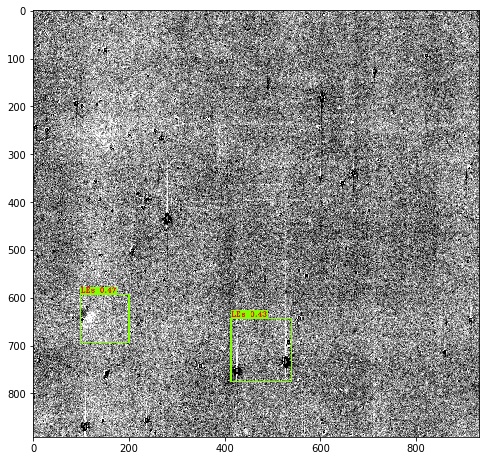

In [154]:
image_path='star/031-04.58650.wp.bin.jpg'
score_th=0.3
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


[array([581.68652344, 476.38278198, 711.20123291, 612.45196533,
          0.75157756,   0.        ]),
 array([6.10238159e+02, 2.03291687e+02, 8.62894043e+02, 4.53526337e+02,
        3.81989986e-01, 0.00000000e+00]),
 array([5.96909241e+02, 1.93329346e+02, 8.66979736e+02, 4.59856415e+02,
        3.70416611e-01, 1.00000000e+00])]

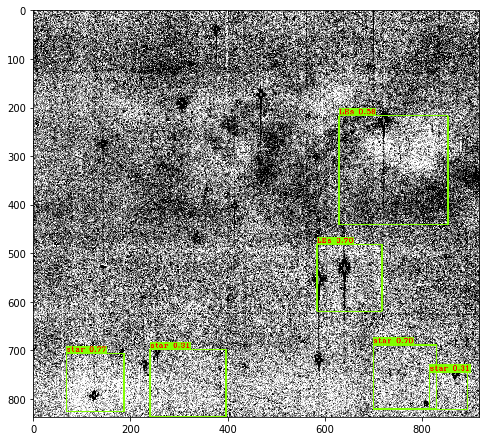

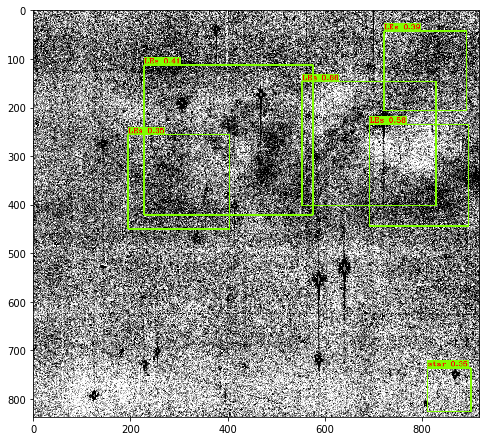

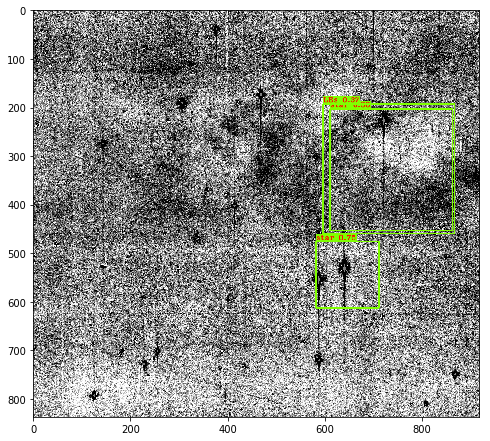

In [156]:
image_path='star/195-05.58600.wp.bin.jpg'
score_th=0.3
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


[]

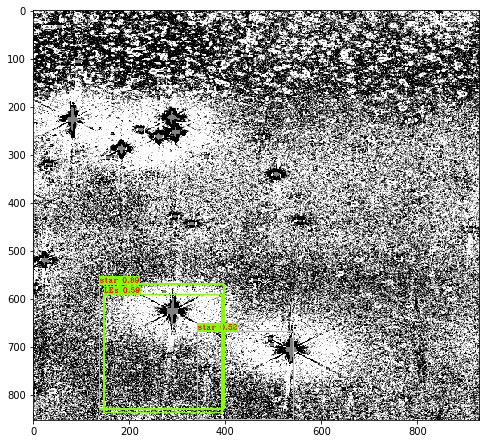

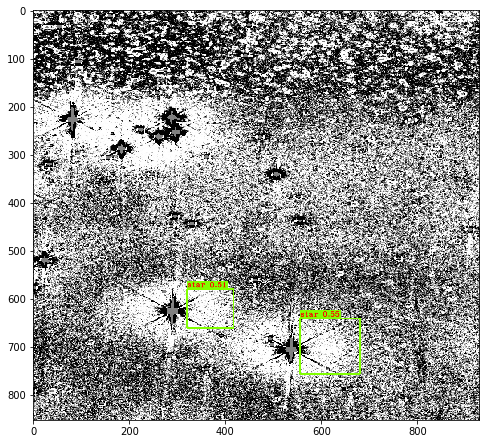

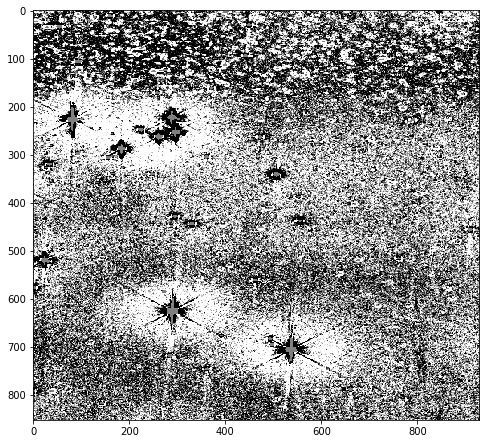

In [162]:
image_path='star/035+59.58450.wp.bin.jpg'
score_th=0.5
iou_th=0.45
detect_(yolo, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_20, image_path=image_path, score_th=score_th, iou_th=iou_th)
detect_(yolo_30, image_path=image_path, score_th=score_th, iou_th=iou_th)


In [93]:
import pandas as pd

In [120]:
loss = pd.read_csv('./star/yolo_loss.csv', sep=',' )


In [121]:
loss.columns

Index(['epoch', 'total_loss', 'total_val_loss'], dtype='object')

Text(0, 0.5, 'loss')

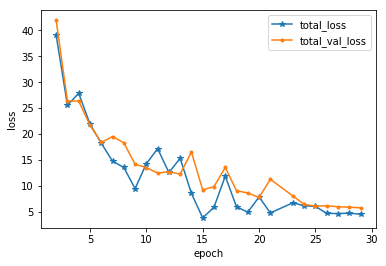

In [132]:
plt.plot(loss.epoch[2:], loss.total_loss[2:], '*-', label='total_loss', )
plt.plot(loss.epoch[2:], loss.total_val_loss[2:],'.-', label='total_val_loss')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('loss')